
# Ungraded Lab: GradCAM

This lab will walk you through generating gradient-weighted class activation maps (GradCAMs) for model predictions.

This is similar to the CAMs you generated before except:
    GradCAMs uses gradients instead of the global average pooling weights to weight the activations.


https://github.com/sasidhar-programmer/Tensorflow_Advance_Techniques/blob/main/3-Advance_computer_vision/week-4/C3_W4_Lab_4_GradCam.ipynb



In [1]:

import warnings 
warnings.filterwarnings("ignore")

import os
import glob
import cv2
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from skimage.io import imread, imsave
from skimage.transform import resize 
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Model
from tensorflow.keras import layers
from tensorflow.keras.applications import vgg16
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import SGD, Adam, RMSprop
from tensorflow.keras.utils import plot_model

import tensorflow as tf
import tensorflow.keras.backend as K
import tensorflow_datasets as tfds
import tensorflow_hub as hub

import imgaug as ia
from imgaug import augmenters as iaa

In [2]:
tfds.disable_progress_bar()

splits = ['train[:80%]', 'train[80%:90%]', 'train[90%:]']

# load the dataset given the splits defined above
splits, info = tfds.load('cats_vs_dogs', with_info=True, as_supervised=True, split = splits)

(train_examples, validation_examples, test_examples) = splits

num_examples = info.splits['train'].num_examples
num_classes = info.features['label'].num_classes

In [3]:
BATCH_SIZE = 32
IMAGE_SIZE = (224, 224)

# resizes the image and normalizes the pixel values
def format_image(image, label):
  image = tf.image.resize(image, IMAGE_SIZE) / 255.0
  return  image, label

# prepare batches
train_batches = train_examples.shuffle(num_examples // 4).map(format_image).batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)
validation_batches = validation_examples.map(format_image).batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)
test_batches = test_examples.map(format_image).batch(1)

In [4]:
tmp_model = vgg16.VGG16(input_shape=IMAGE_SIZE + (3,),
                             weights='imagenet', include_top=False)

tmp_model.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

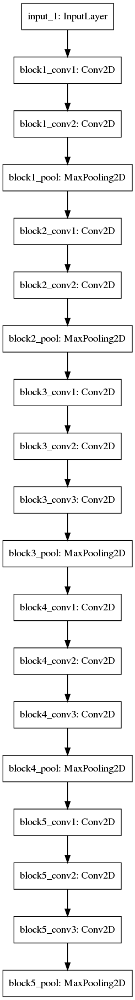

In [5]:
plot_model(tmp_model)


In [6]:
tmp_model.output

<KerasTensor: shape=(None, 7, 7, 512) dtype=float32 (created by layer 'block5_pool')>

## Modelling
You will use a pre-trained VGG16 network as your base model for the classifier. This will be followed by a global average pooling (GAP) and a 2-neuron Dense layer with softmax activation for the output. The earlier VGG blocks will be frozen and we will just fine-tune the final layers during training. These steps are shown in the utility function below

In [7]:
def build_model():
    # the top is a classifier Dense, which we don't want
    base_model = vgg16.VGG16(input_shape=IMAGE_SIZE + (3,),
                             weights='imagenet', include_top=False)
    
    # add a Global-avg-pooling layer
    output = layers.GlobalAveragePooling2D()(base_model.output)

    # the output has 2 neurons for each of the 2 classes( cats and dogs)
    output = layers.Dense(2, activation='softmax')(output)

    # set the inputs and outputs of the model
    model = Model(base_model.input, output)

    # freeze earlier layers
    for layer in base_model.layers[:-4]:
        layer.trainable = False
    
    optimizer = tf.keras.optimizers.Adam()
    
    model.compile(loss='sparse_categorical_crossentropy', optimizer=optimizer,
                metrics=['accuracy'])
    model.summary()

    return model
    

In [8]:
print( "now we build the real model we will use ")
model = build_model()

now we build the real model we will use 
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPool

In [10]:
checkpoint_path = "./training/cp.ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)
# checkpoint_dir

# Create a callback that saves the model's weights
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                                 save_weights_only=True,
                                                 verbose=1)

try:
    model.load_weights(checkpoint_path)
    print('loading from checkpoint')
except:
    print('training model')
    EPOCHS = 3
    model.fit(train_batches,
            epochs=EPOCHS,
            validation_data=validation_batches, callbacks=[cp_callback])
    print(os.listdir(checkpoint_dir))

loading from checkpoint


In [12]:

model.history.history

{'loss': [0.7118503451347351],
 'accuracy': [0.5009135007858276],
 'val_loss': [0.6935731172561646],
 'val_accuracy': [0.4815133213996887]}


## Model Interpretability

Let's now go through the steps to generate the class activation maps. You will start by specifying the layers you want to visualize.


In [13]:
print(len(model.layers))
outputs = [layer.output for layer in model.layers[1:18]]

# Define a new model that generates the above output
vis_model = Model(model.input, outputs)

# store the layer names we are interested in
layer_names = []
for layer in outputs:
    layer_names.append(layer.name.split("/")[0])

    
print("Layers that will be used for visualization: ")
print(layer_names)

21
Layers that will be used for visualization: 
['block1_conv1', 'block1_conv2', 'block1_pool', 'block2_conv1', 'block2_conv2', 'block2_pool', 'block3_conv1', 'block3_conv2', 'block3_conv3', 'block3_pool', 'block4_conv1', 'block4_conv2', 'block4_conv3', 'block4_pool', 'block5_conv1', 'block5_conv2', 'block5_conv3']


In [14]:
# We'll define a few more functions to output the maps. get_CAM() is the function highlighted
# in the lectures and takes care of generating the heatmap of
# gradient weighted features. show_random_sample() takes care of plotting the results.

def get_CAM(processed_image, actual_label, layer_name='block5_conv3'):
    # create a secondary model so we can get the certain layer outputs along with model's output
    model_grad = Model(inputs=[model.inputs],
     outputs = [model.get_layer(layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_output_values, predictions = model_grad(processed_image)
        
        # watch the conv_output_value
        tape.watch(conv_output_values)

        ## Use binary cross entropy loss
        # get prediction probability of dog
        # If model is good then pred_prob will be close to 0 if cat, close to 1 if dog
        pred_prob = predictions[:,1] # this gives us the loss for the predicted label
        
        # make sure actual_label is a float, like the rest of the loss calculation
        actual_label = tf.cast(actual_label, dtype=tf.float32)
        
        # add a tiny value to avoid log of 0
        smoothing = 0.00001
        log = tf.math.log

        # calculate loss as binary cross entropy
        loss = -1 * (actual_label * log(pred_prob + smoothing) + (1 - actual_label) * log(1 - pred_prob + smoothing))
        print(f"binary loss: {loss}")

    # this is like we did for salience mapping 
    # get the gradient of the loss with respect to the outputs of the last conv layer
    # this is the gradients across all feature maps
    grad_values = tape.gradient(loss, conv_output_values)
    # average the gradient across feature maps to effectively stack them on each other
    # axis property ensures we do it across all 3 channels
    grads_values = K.mean(grad_values, axis=(0,1,2))

    conv_output_values = np.squeeze(conv_output_values.numpy())# toss away scalers and single dim values to clean data
    grads_values = grads_values.numpy()

    # weight the convolution outputs with the computed gradients
    # multiply learned filter outputs with their grad values
    for i in range(512): # we have 512 features in the last conv layer
        conv_output_values[:, :,i] *= grads_values[i]
    
    heatmap = np.mean(conv_output_values, axis=-1) # stack the results by making them into a mean
    heatmap = np.maximum(heatmap, 0) # remove negative values
    heatmap /= heatmap.max() # normalize to get a good gradient over all the values
    
    del model_grad, conv_output_values, grads_values, loss
   
    return heatmap


In [30]:
def show_sample(idx=None):
    if idx:
        for img, label in test_batches.take(idx):
            sample_image = img [0]
            sample_label = label[0]
    else:
        for img, label in test_batches.shuffle(1000).take(1):
            sample_image = img[0]
            sample_label = label[0]
    sample_image_processed = np.expand_dims(sample_image, axis=0)
    activations = vis_model.predict(sample_image_processed)
    prediction = model.predict(sample_image_processed)
    pred_label = np.argmax(prediction, axis=-1)[0]

    sample_activation = activations[0][0,:,:,16]
    sample_activation-=sample_activation.mean()
    sample_activation/=sample_activation.std()
    sample_activation *=255
    sample_activation/=np.clip(sample_activation, 0, 255).astype(np.uint8)

    heatmap = get_CAM(sample_image_processed, sample_label)
    heatmap = cv2.resize(heatmap, (sample_image.shape[0], sample_image.shape[1]))
    heatmap = heatmap*255
    heatmap = np.clip(heatmap, 0, 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_HOT)
    converted_img = sample_image.numpy()
    super_imposed_image = cv2.addWeighted(converted_img, 0.8, heatmap.astype('float32'), 2e-3, 0.0)

    f,ax = plt.subplots(2,2, figsize=(15,8))

    ax[0,0].imshow(sample_image)
    ax[0,0].set_title(f"True label: {sample_label} \n Predicted label: {pred_label}")
    ax[0,0].axis('off')
    
    ax[0,1].imshow(sample_activation)
    ax[0,1].set_title("Random feature map")
    ax[0,1].axis('off')
    
    ax[1,0].imshow(heatmap)
    ax[1,0].set_title("Class Activation Map")
    ax[1,0].axis('off')
    
    ax[1,1].imshow(super_imposed_image)
    ax[1,1].set_title("Activation map superimposed")
    ax[1,1].axis('off')
    plt.tight_layout()
    plt.show()
  
    return activations

binary loss: [0.6830505]


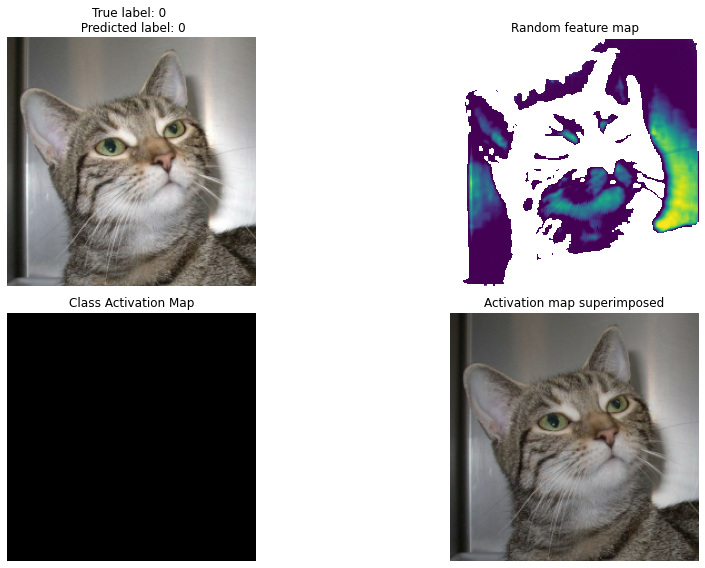

In [34]:

# Choose an image index to show, or leave it as None to get a random image
activations = show_sample(idx=4)




### Intermediate activations of layers

You can use the utility function below to visualize the activations in the intermediate layers you defined earlier. This plots the feature side by side for each convolution layer starting from the earliest layer all the way to the final convolution layer.


In [35]:
def visualize_intermediate_activations(layer_names, activations):
    assert len(layer_names)==len(activations), "Make sure layers and activation values match"
    images_per_row=16
    for layer_name, layer_activation in zip(layer_names, activations):
        num_features = layer_activation.shape[-1]
        size = layer_activation.shape[1]
        num_cols = num_features // images_per_row
        grid = np.zeros( (size*num_cols, size*images_per_row) )

        for col in range(num_cols):
            for row in range(images_per_row):
                feature_map = layer_activation[0,:,:,col*images_per_row + row]
                feature_map -= feature_map.mean()
                feature_map /= feature_map.std()
                feature_map *=255
                feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)

                grid[col*size:(col+1)*size, row*size:(row+1)*size] = feature_map

        scale = 1./size
        plt.figure(figsize=(scale*grid.shape[1], scale*grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.axis('off')
        plt.imshow(grid, aspect='auto', cmap='viridis')
    plt.show()


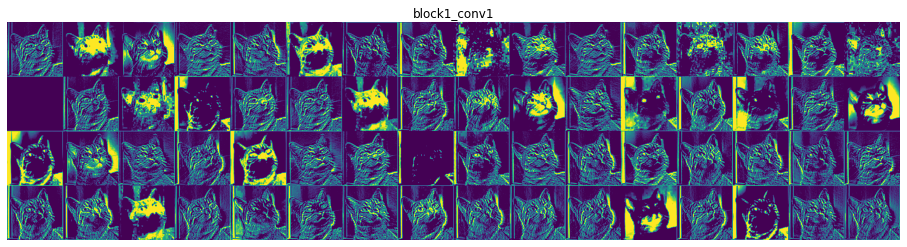

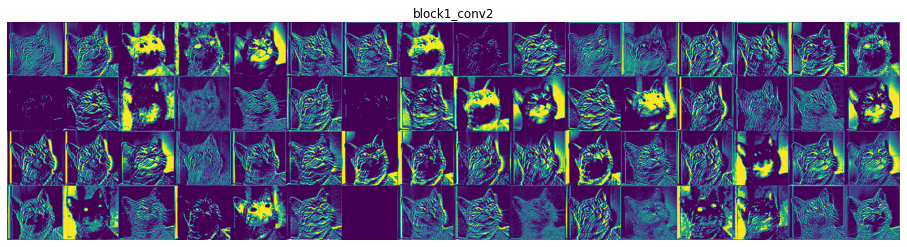

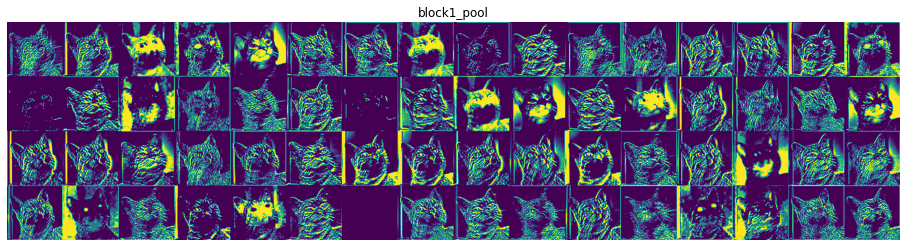

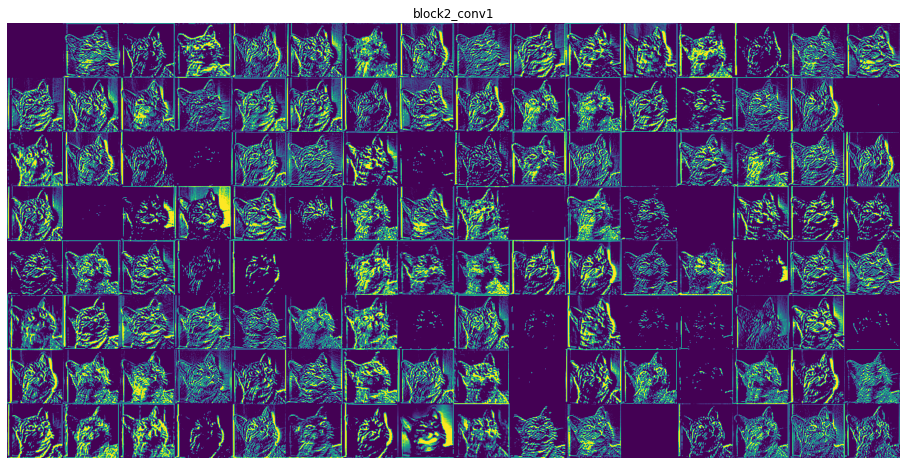

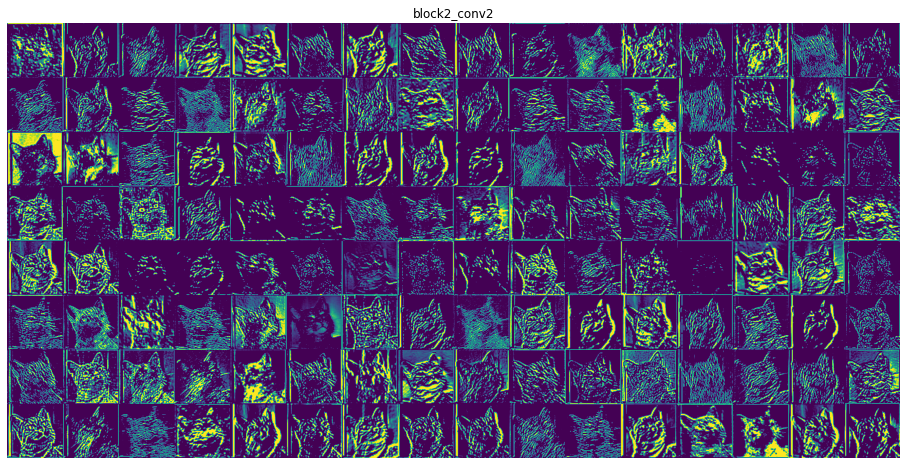

...

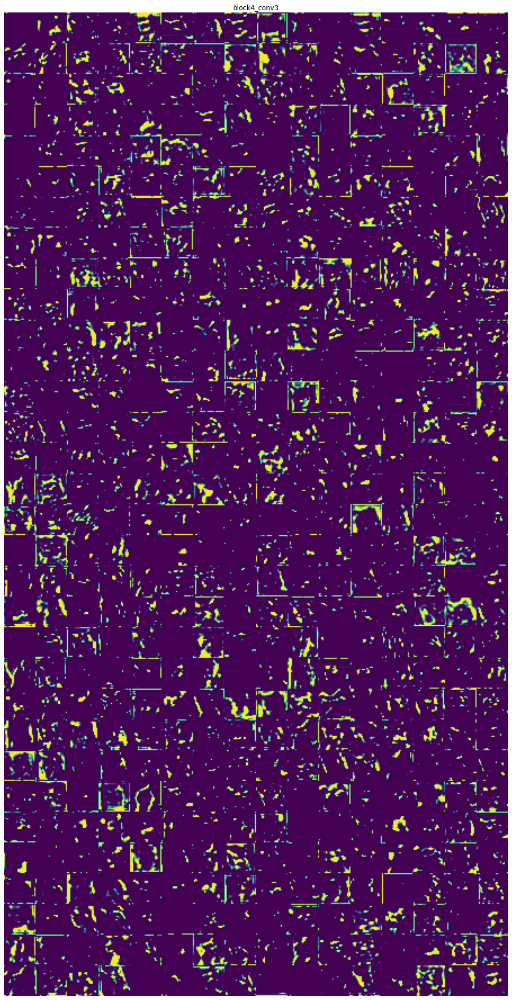

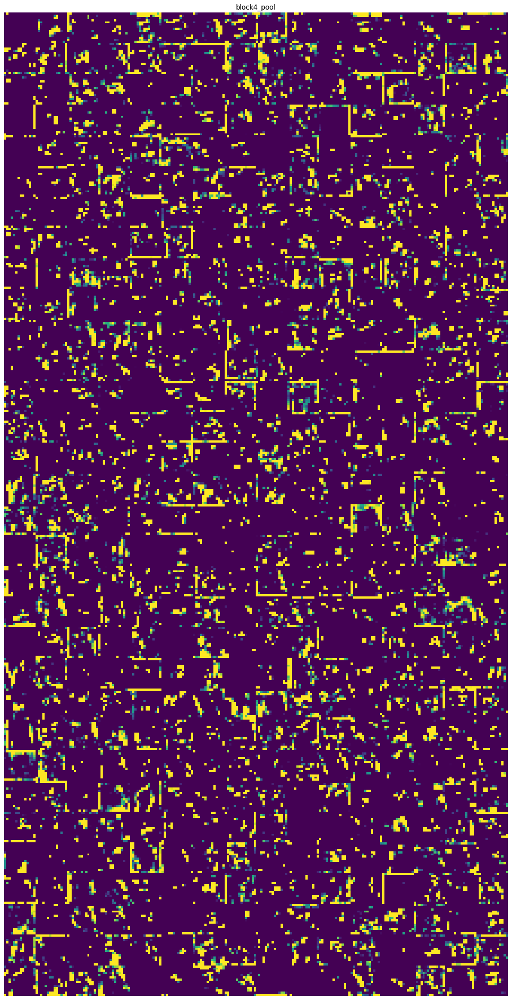

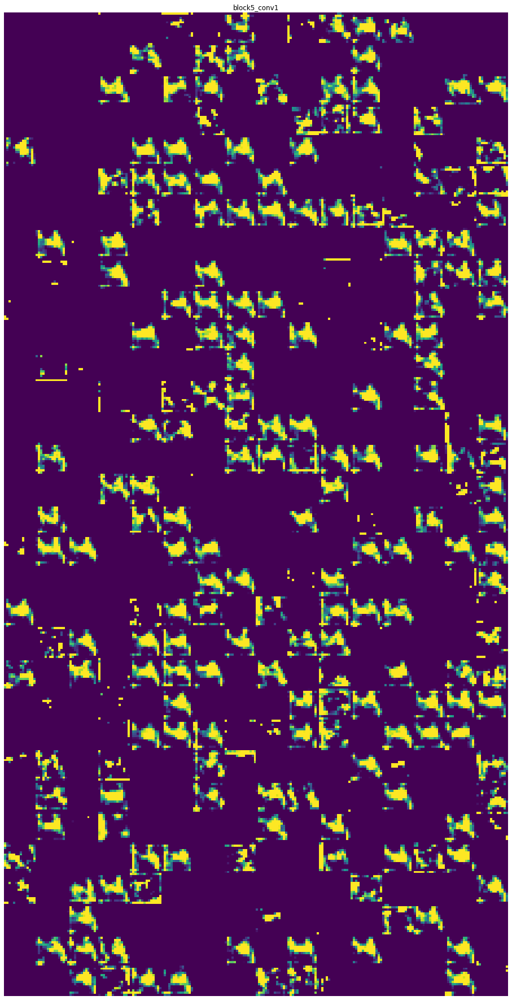

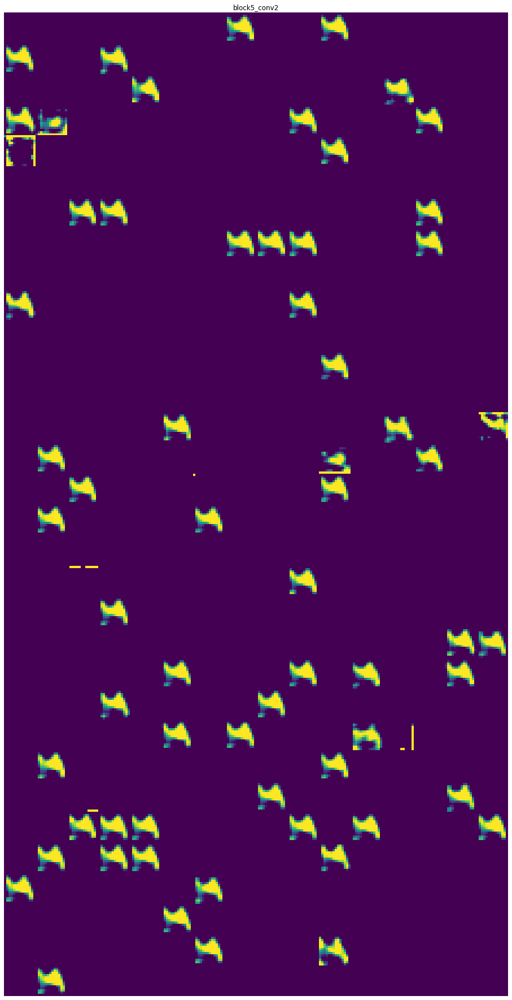

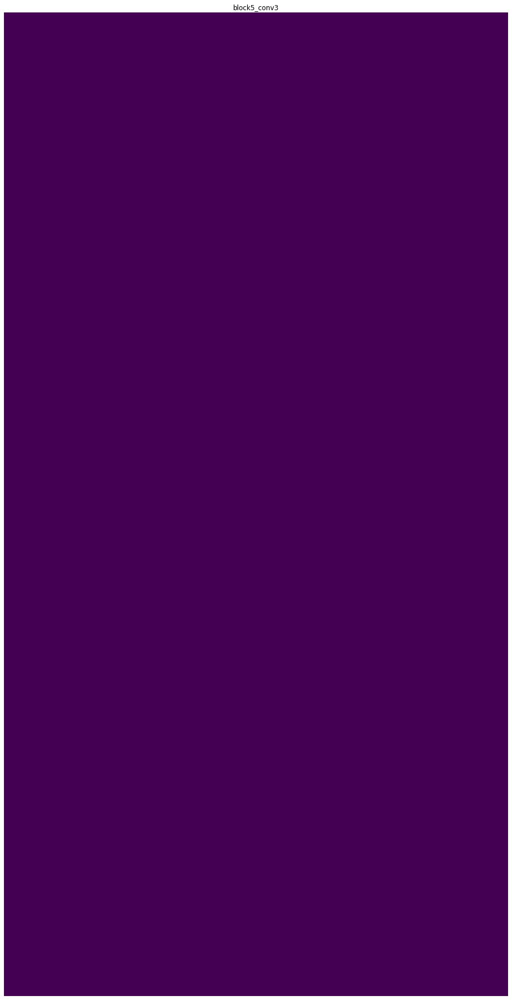

In [36]:
visualize_intermediate_activations(activations=activations, 
                                   layer_names=layer_names)



If you scroll all the way down to see the outputs of the final conv layer, you'll see that there are very few active features and these are mostly located in the face of the cat. This is the region of the image that your model looks at when determining the class.
